In [ ]:

######## snakemake preamble start (automatically inserted, do not edit) ########
import sys; sys.path.extend(['c:\\work\\miniconda3\\envs\\cartography\\lib\\site-packages', 'C:\\work\\cartography\\notebooks']); import pickle; snakemake = pickle.loads(b'\x80\x03csnakemake.script\nSnakemake\nq\x00)\x81q\x01}q\x02(X\x05\x00\x00\x00inputq\x03csnakemake.io\nInputFiles\nq\x04)\x81q\x05(X3\x00\x00\x00notebooks/Data/aligned_cdc_h3n2_ha_2y_cell_hi.fastaq\x06X\x13\x00\x00\x00notebooks/input.txtq\x07X \x00\x00\x00notebooks/Data/type_of_virus.txtq\x08X0\x00\x00\x00notebooks/Data/flu_seasonal_h3n2_ha_2y_tree.jsonq\te}q\nX\x06\x00\x00\x00_namesq\x0b}q\x0csbX\x06\x00\x00\x00outputq\rcsnakemake.io\nOutputFiles\nq\x0e)\x81q\x0f(X\x1a\x00\x00\x00docs/FullViolinPlotFlu.pngq\x10X\x1b\x00\x00\x00docs/FullScatterplotFlu.pngq\x11X$\x00\x00\x00docs/FullLinkedChartClickableFlu.pngq\x12X%\x00\x00\x00docs/FullLinkedChartClickableFlu.htmlq\x13e}q\x14h\x0b}q\x15sbX\x06\x00\x00\x00paramsq\x16csnakemake.io\nParams\nq\x17)\x81q\x18}q\x19h\x0b}q\x1asbX\t\x00\x00\x00wildcardsq\x1bcsnakemake.io\nWildcards\nq\x1c)\x81q\x1d}q\x1eh\x0b}q\x1fsbX\x07\x00\x00\x00threadsq K\x01X\t\x00\x00\x00resourcesq!csnakemake.io\nResources\nq")\x81q#(K\x01K\x01e}q$(h\x0b}q%(X\x06\x00\x00\x00_coresq&K\x00N\x86q\'X\x06\x00\x00\x00_nodesq(K\x01N\x86q)uh&K\x01h(K\x01ubX\x03\x00\x00\x00logq*csnakemake.io\nLog\nq+)\x81q,}q-h\x0b}q.sbX\x06\x00\x00\x00configq/}q0X\x04\x00\x00\x00ruleq1X\x03\x00\x00\x00runq2X\x0f\x00\x00\x00bench_iterationq3NX\t\x00\x00\x00scriptdirq4X\x1d\x00\x00\x00C:\\work\\cartography\\notebooksq5ub.'); from snakemake.logging import logger; logger.printshellcmds = True; import os; os.chdir('C:\work\cartography');
######## snakemake preamble end #########


# This is Cartography put together into one place. 

## Modules to add to run this code:

- [BioPython][1]
- [Pandas][2]
- [Numpy][3]
- [Altair][4]
- [Seaborn][5]
- [Scikit-Learn][6]
- [UMAP][7]
- json
- nextstrain-augur
- statsmodels
[1]:https://biopython.org/wiki/Download
[2]:https://pandas.pydata.org/pandas-docs/version/0.23.3/install.html
[3]:https://docs.scipy.org/doc/numpy/user/quickstart.html
[4]:https://altair-viz.github.io/getting_started/installation.html
[5]:https://seaborn.pydata.org/installing.html
[6]:https://scikit-learn.org/stable/install.html
[7]:https://umap-learn.readthedocs.io/en/latest/


# Imports Section 

In [2]:
import pandas as pd
import altair as alt
import numpy as np
from scipy.spatial.distance import squareform, pdist
from Bio import SeqIO
import seaborn as sns
import re
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from augur.utils import json_to_tree
import json
from sklearn.manifold import MDS
from sklearn.manifold import TSNE
import umap
from scipy.stats import linregress
from pathlib import Path
import statsmodels
import statistics
import matplotlib.pyplot as plt
from Helpers import get_euclidean_data_frame, get_hamming_distances, linking_tree_with_plots_brush
from Helpers import linking_tree_with_plots_clickable
from Helpers import scatterplot_xyvalues, scatterplot_tooltips, scatterplot_with_tooltip_interactive
import selenium
from selenium.webdriver import Chrome 
%matplotlib inline

C:\Work\Miniconda3\envs\cartography\lib\site-packages\umap\spectral.py:4: NumbaDeprecationWarning: No direct replacement for 'numba.targets' available. Visit https://gitter.im/numba/numba-dev to request help. Thanks!
  import numba.targets


In [3]:
from selenium import webdriver

chrome_options = webdriver.ChromeOptions()
chrome_options.add_argument('--headless')
chrome_options.add_argument('--no-sandbox')
chrome_options.add_argument('--disable-dev-shm-usage')

browser = webdriver.Chrome(options=chrome_options)

## Pathogen-specific variables

Consider consolidating these into a single configuration file that can be passed to the notebook as a command line argument for more scriptable generation of these figures.

# Flu Specific Variables

In [4]:
dropped_strains = [line.rstrip('\n') for line in open(snakemake.input[1],"r")]
tree_path = snakemake.input[3]
path = snakemake.input[0]
if(len(snakemake.input) > 3):
    clades_to_plot = [line.rstrip('\n') for line in open(snakemake.input[2],"r")]

# Zika Specific Variables 

### Reading in the Fasta File
- I used BioPython to parse the Fasta file into two numpy Arrays: Genomes and Strains. 

In [5]:
#work on making this work
strains = []
genomes = []
for record in SeqIO.parse(path, "fasta"):
    if(record.id not in dropped_strains):
        strains.append(str(record.id))
        genomes.append(str(record.seq))

#### Checking to make sure the file I picked is a aligned Fasta file / is the file I wanted

In [6]:
len(strains)
print(len(genomes[0]) == len(genomes[1]))
print(len(genomes))

True
2085


In [7]:
strains[:5]

['A/Oman/5263/2017',
 'A/Oman/5101/2017',
 'A/Madagascar/424/2018',
 'A/Phetchaburi/104/2018',
 'A/Philippines/160/2018']

In [8]:
genomes_df = pd.DataFrame(genomes)
strains_df = pd.DataFrame(strains)

In [9]:
genomes_missing_bases = []
for x in genomes:
    x = re.sub(r'[^AGCT]', '5', x)
    numberOfN = x.count("5")
    genomes_missing_bases.append(numberOfN)

In [10]:
genomes_missing_bases_df = pd.DataFrame(genomes_missing_bases)
genomes_missing_bases_df = genomes_missing_bases_df.merge(strains_df, how='outer', left_index = True, right_index = True)
genomes_missing_bases_df.columns = ["bases missing", "strain"]

# Missing Bases

In [11]:
genomes_missing_bases_df.head()

,bases missing,strain
0,3,A/Oman/5263/2017
1,3,A/Oman/5101/2017
2,5,A/Madagascar/424/2018
3,3,A/Phetchaburi/104/2018
4,3,A/Philippines/160/2018


In [12]:
alt.Chart(genomes_missing_bases_df).mark_bar().encode(
    alt.X("bases missing:Q", bin=True),
    y="count()"
)

<VegaLite 3 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/troubleshooting.html


In [13]:
# Also, consider storing the list of dropped strains in a text file outside of the notebook.
dropped_strains.extend(list(genomes_missing_bases_df[genomes_missing_bases_df["bases missing"]>1000]["strain"]))

In [14]:
#work on making this work
strains = []
genomes = []
for record in SeqIO.parse(path, "fasta"):
    if(record.id not in dropped_strains):
        strains.append(str(record.id))
        genomes.append(str(record.seq))

In [15]:
len(strains)
print(len(genomes[0]) == len(genomes[1]))
print(len(genomes))

True
2085


In [16]:
strains[:5]

['A/Oman/5263/2017',
 'A/Oman/5101/2017',
 'A/Madagascar/424/2018',
 'A/Phetchaburi/104/2018',
 'A/Philippines/160/2018']

In [17]:
genomes_df = pd.DataFrame(genomes)
strains_df = pd.DataFrame(strains)
genomes_df.columns = ["strain"]

# Creating the Distance Matrix
- I used Hamming Distance to find the pairwise distance between each genome and each other genome, effectively creating a similarity/distance matrix
    - In my Hamming Distance method, I only counted something as a different if it was a mismatch between the nucleotides (A,G,C, or T), not gaps (as that was throwing off the algorithm too much for smaller strains)
- I then used Seaborn to generate a heatmap to make sure the matrix looked correct

In [18]:
%%time
# Try to load an existing distance matrix. Create it, if it doesn't already exist.
"""try:
    # The index should be the first column and correspond to strain name for the row.
    similarity_matrix = pd.read_csv(distance_matrix_file, index_col=0)
    print("Loaded existing distance matrix")
except FileNotFoundError:
    print("Could not find existing distance matrix, creating it now", end="...")
"""    
# Calculate Hamming distances.
hamming_distances = get_hamming_distances(genomes)

# Convert distinct pairwise distances into the more redundant but more interpretable square matrix.
similarity_matrix = squareform(hamming_distances)

# Convert the numpy matrix to a pandas data frame with strain annotations for rows and columns.
similarity_matrix = pd.DataFrame(
    similarity_matrix,
    columns=strains,
    index=strains
)

# Write out the resulting data frame to cache distance calculations.
# Keep the index in the output file, so it is immediately available on read.
#similarity_matrix.to_csv(distance_matrix_file)
print("done!")

done!
Wall time: 54.2 s


In [19]:
similarity_matrix

,A/Oman/5263/2017,A/Oman/5101/2017,A/Madagascar/424/2018,A/Phetchaburi/104/2018,A/Philippines/160/2018,A/NewZealand/2379/2017,A/NewZealand/2391/2017,A/Philippines/799/2017,A/NewZealand/2267/2017,A/Colombia/6187/2017,...,A/Hokkaido/7/2018,A/Nagano/2283/2018,A/Lyon/1560/2018,A/Taiwan/81136/2018,A/Swansea/699/2018,A/SaoPaulo/706496/2018,A/Perth/151/2018,A/Concepcion/87275/2018,A/Kaliningrad/17/2018,A/Shimane/112/2017
A/Oman/5263/2017,0,3,4,6,5,6,6,6,7,8,...,41,40,32,41,36,33,35,34,39,37
A/Oman/5101/2017,3,0,3,5,4,5,5,5,6,7,...,40,39,31,40,35,32,34,33,38,34
A/Madagascar/424/2018,4,3,0,6,5,6,6,6,7,8,...,41,40,32,41,36,33,35,34,39,37
A/Phetchaburi/104/2018,6,5,6,0,1,2,2,2,3,4,...,39,36,30,39,34,31,33,32,37,35
A/Philippines/160/2018,5,4,5,1,0,1,1,1,2,3,...,38,37,29,38,33,30,32,31,36,34
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
A/SaoPaulo/706496/2018,33,32,33,31,30,31,31,31,32,32,...,19,16,13,19,14,0,11,11,17,16
A/Perth/151/2018,35,34,35,33,32,33,33,33,34,34,...,14,13,15,16,11,11,0,13,14,20
A/Concepcion/87275/2018,34,33,34,32,31,32,32,32,33,33,...,21,18,14,21,16,11,13,0,17,21
A/Kaliningrad/17/2018,39,38,39,37,36,37,37,37,38,38,...,22,19,20,22,17,17,14,17,0,24


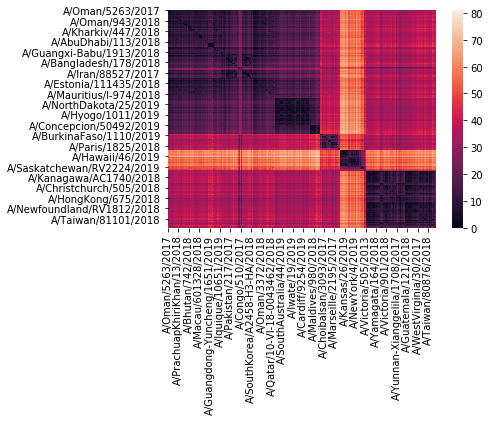

In [20]:
sns.heatmap(similarity_matrix)

# Creating the Phylogenetic Tree in Altair
- I used Altair to make this tree (Documentation linked [here][1]
- I opened and imported the json from a build from NextStrain ([flu][2], [zika][3], etc)
- The data from the JSON and the Data from the tree are usually a little different, so after merging the two dataframes you may get some errors.

[1]: https://altair-viz.github.io/index.html
[2]: https://github.com/nextstrain/seasonal-flu
[3]: https://altair-viz.github.io/index.html

In [21]:
with open(tree_path) as fh:
    json_tree_handle = json.load(fh)

In [22]:
tree = json_to_tree(json_tree_handle)

In [23]:
tree

Clade(branch_length=0, clade=3769, name='NODE_0002093', numdate=2012.5519511386733, strain='NODE_0002093', yvalue=1985.2580021129058)

In [24]:
node_data = [
    {
        "strain": node.name,
        "date": node.attr["num_date"],
        "y": node.yvalue,
        "region": node.attr["region"],
        "country": node.attr["country"],
        "parent_date": node.parent is not None and node.parent.attr["num_date"] or node.attr["num_date"],
        "parent_y": node.parent is not None and node.parent.yvalue or node.yvalue,
        "clade_membership" : node.attr['clade_membership']
    }
    for node in tree.find_clades(terminal=True)
]

In [25]:
node_data[10]

{'strain': 'A/Texas/88/2016',
 'date': 2016.1505817932923,
 'y': 2083,
 'region': 'north_america',
 'country': 'usa',
 'parent_date': 2015.1390475527255,
 'parent_y': 2082.25,
 'clade_membership': '3c3.A'}

In [26]:
node_df = pd.DataFrame(node_data)

In [27]:
node_df.head()

,strain,date,y,region,country,parent_date,parent_y,clade_membership
0,A/Almaty/2958/2013,2013.073922,2093,west_asia,kazakhstan,2012.995475,2091.519618,3c3
1,A/Victoria/505/2013,2013.459959,2092,oceania,australia,2013.293896,2091.500000,3c3
2,A/Newcastle/22/2014,2014.457221,2091,oceania,australia,2013.293896,2091.500000,3c3.B
3,A/Stockholm/6/2014,2014.101300,2090,europe,sweden,2013.840269,2088.578472,3c3.A
4,A/Switzerland/9715293/2013,2013.930869,2089,europe,switzerland,2013.930869,2087.156945,3c3.A


In [28]:
node_df["y"] = node_df["y"].max() - node_df["y"]

In [29]:
node_df["parent_y"] = node_df["parent_y"].max() - node_df["parent_y"]

In [30]:
node_df.shape

(2093, 8)

In [31]:
node_df.head()

,strain,date,y,region,country,parent_date,parent_y,clade_membership
0,A/Almaty/2958/2013,2013.073922,0,west_asia,kazakhstan,2012.995475,0.000000,3c3
1,A/Victoria/505/2013,2013.459959,1,oceania,australia,2013.293896,0.019618,3c3
2,A/Newcastle/22/2014,2014.457221,2,oceania,australia,2013.293896,0.019618,3c3.B
3,A/Stockholm/6/2014,2014.101300,3,europe,sweden,2013.840269,2.941146,3c3.A
4,A/Switzerland/9715293/2013,2013.930869,4,europe,switzerland,2013.930869,4.362673,3c3.A


In [32]:
node_df["region"].unique()

array(['west_asia', 'oceania', 'europe', 'japan_korea', 'china',
       'north_america', 'south_america', 'africa', 'south_asia',
       'southeast_asia'], dtype=object)

In [33]:
# Reannotate clades that we aren't interested in as "other" to simplify color assignment in visualizations.
try:
    node_df["clade_membership_color"] = node_df["clade_membership"].apply(lambda clade: clade if clade in clades_to_plot else "other")
except:
    node_df["clade_membership_color"] = node_df["clade_membership"]
    print("clades_to_plot undefined")

In [34]:
indices_to_drop = similarity_matrix[~similarity_matrix.index.isin(node_df["strain"])].dropna(how = 'all')
similarity_matrix = similarity_matrix[similarity_matrix.index.isin(node_df["strain"])].dropna(how = 'all')
similarity_matrix = similarity_matrix.drop(indices_to_drop.index, axis=1)
similarity_matrix

,A/Oman/5263/2017,A/Oman/5101/2017,A/Madagascar/424/2018,A/Phetchaburi/104/2018,A/Philippines/160/2018,A/NewZealand/2379/2017,A/NewZealand/2391/2017,A/Philippines/799/2017,A/NewZealand/2267/2017,A/Colombia/6187/2017,...,A/Hokkaido/7/2018,A/Nagano/2283/2018,A/Lyon/1560/2018,A/Taiwan/81136/2018,A/Swansea/699/2018,A/SaoPaulo/706496/2018,A/Perth/151/2018,A/Concepcion/87275/2018,A/Kaliningrad/17/2018,A/Shimane/112/2017
A/Oman/5263/2017,0,3,4,6,5,6,6,6,7,8,...,41,40,32,41,36,33,35,34,39,37
A/Oman/5101/2017,3,0,3,5,4,5,5,5,6,7,...,40,39,31,40,35,32,34,33,38,34
A/Madagascar/424/2018,4,3,0,6,5,6,6,6,7,8,...,41,40,32,41,36,33,35,34,39,37
A/Phetchaburi/104/2018,6,5,6,0,1,2,2,2,3,4,...,39,36,30,39,34,31,33,32,37,35
A/Philippines/160/2018,5,4,5,1,0,1,1,1,2,3,...,38,37,29,38,33,30,32,31,36,34
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
A/SaoPaulo/706496/2018,33,32,33,31,30,31,31,31,32,32,...,19,16,13,19,14,0,11,11,17,16
A/Perth/151/2018,35,34,35,33,32,33,33,33,34,34,...,14,13,15,16,11,11,0,13,14,20
A/Concepcion/87275/2018,34,33,34,32,31,32,32,32,33,33,...,21,18,14,21,16,11,13,0,17,21
A/Kaliningrad/17/2018,39,38,39,37,36,37,37,37,38,38,...,22,19,20,22,17,17,14,17,0,24


In [35]:
node_df.head()

,strain,date,y,region,country,parent_date,parent_y,clade_membership,clade_membership_color
0,A/Almaty/2958/2013,2013.073922,0,west_asia,kazakhstan,2012.995475,0.000000,3c3,other
1,A/Victoria/505/2013,2013.459959,1,oceania,australia,2013.293896,0.019618,3c3,other
2,A/Newcastle/22/2014,2014.457221,2,oceania,australia,2013.293896,0.019618,3c3.B,other
3,A/Stockholm/6/2014,2014.101300,3,europe,sweden,2013.840269,2.941146,3c3.A,3c3.A
4,A/Switzerland/9715293/2013,2013.930869,4,europe,switzerland,2013.930869,4.362673,3c3.A,3c3.A


## Checking for Outliers in Pairwise Distance

In [36]:
mean_distances = similarity_matrix.mean().reset_index(name="mean_distance").rename(columns={"index": "strain"})

In [37]:
mean_distances.head()

,strain,mean_distance
0,A/Oman/5263/2017,22.832134
1,A/Oman/5101/2017,21.975060
2,A/Madagascar/424/2018,22.729017
3,A/Phetchaburi/104/2018,22.284412
4,A/Philippines/160/2018,21.293525


In [38]:
alt.Chart(mean_distances, height=150).mark_boxplot().encode(
    x = alt.X('mean_distance', title="mean of pairwise distances"),
    tooltip = ["strain"]
)

<VegaLite 3 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/troubleshooting.html


# Running PCA on Scaled and Centered Data
- I treated each nucleotide as a "site", or dimension, and found the probability of having a certain nucleotide given the frequency of that letter at that site.
- I used [this paper][1] as my source 
- The equation is as follows where C is the matrix of dimensions, M is the mean, and p is the frequency of a nucleotide at that given site. 
![](https://journals.plos.org/plosgenetics/article/file?type=thumbnail&id=info:doi/10.1371/journal.pgen.0020190.e003)

In [39]:
numbers = genomes[:]
for i in range(0,len(genomes)):
    numbers[i] = re.sub(r'[^AGCT]', '5', numbers[i])
    numbers[i] = list(numbers[i].replace('A','1').replace('G','2').replace('C', '3').replace('T','4'))
    numbers[i] = [int(j) for j in numbers[i]]
genomes_df = pd.DataFrame(numbers)
genomes_df.columns = ["Site " + str(k) for k in range(0,len(numbers[i]))]

In [40]:
genomes_df.head()

,Site 0,Site 1,Site 2,Site 3,Site 4,Site 5,Site 6,Site 7,Site 8,Site 9,...,Site 1691,Site 1692,Site 1693,Site 1694,Site 1695,Site 1696,Site 1697,Site 1698,Site 1699,Site 1700
0,1,4,2,1,1,2,1,3,4,1,...,4,4,2,3,1,4,4,5,5,5
1,1,4,2,1,1,2,1,3,4,1,...,4,4,2,3,1,4,4,5,5,5
2,1,4,2,1,1,2,1,3,4,1,...,4,4,2,3,1,4,4,5,5,5
3,1,4,2,1,1,2,1,3,4,1,...,4,4,2,3,1,4,4,5,5,5
4,1,4,2,1,1,2,1,3,4,1,...,4,4,2,3,1,4,4,5,5,5


In [41]:
#performing PCA on my pandas dataframe 
pca = PCA(n_components=10,svd_solver='full') #can specify n, since with no prior knowledge, I use None
principalComponents = pca.fit_transform(genomes_df)

In [42]:
# Create a data frame from the PCA embedding.
principalDf = pd.DataFrame(data = principalComponents, columns = ["PCA" + str(i) for i in range(1,11)])

# Annotate rows by their original strain names. PCA rows are in the same order as
# the `genomes` rows which are in the same order as the `strains` rows.
principalDf["strain"] = strains

In [43]:
df = pd.concat([pd.DataFrame(np.arange(1,11)), pd.DataFrame([round(pca.explained_variance_ratio_[i],4) for i in range(0,len(pca.explained_variance_ratio_))])], axis = 1)
df.columns = ['principal components','explained variance']
df

,principal components,explained variance
0,1,0.2354
1,2,0.1953
2,3,0.1877
3,4,0.0593
4,5,0.0356
5,6,0.0208
6,7,0.0177
7,8,0.0116
8,9,0.0105
9,10,0.0090


In [44]:
alt.Chart(df).mark_point().encode(
    x='principal components:Q',
    y='explained variance:Q'
)

<VegaLite 3 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/troubleshooting.html


In [45]:
merged_pca_df = principalDf.merge(node_df, on="strain")

In [46]:
merged_pca_df.head()

,PCA1,PCA2,PCA3,PCA4,PCA5,PCA6,PCA7,PCA8,PCA9,PCA10,strain,date,y,region,country,parent_date,parent_y,clade_membership,clade_membership_color
0,-3.102729,-0.863257,0.275775,0.526773,-0.439664,-0.547782,0.012023,-0.113029,-0.104291,0.002438,A/Oman/5263/2017,2017.733744,1331,west_asia,oman,2017.543574,1492.976243,A1b/135K,A1b/135K
1,-3.099599,-0.873706,0.285021,0.426246,-0.575571,-0.555928,0.027758,-0.090723,-0.050832,0.090828,A/Oman/5101/2017,2017.739220,1341,west_asia,oman,2017.598698,1340.019618,A1b/135K,A1b/135K
2,-3.092304,-0.798542,0.250964,0.412692,-0.622087,-0.638609,0.039610,-0.117175,-0.092316,-0.026142,A/Madagascar/424/2018,2018.101300,1700,africa,madagascar,2017.933265,1698.019618,A1b/135K,A1b/135K
3,-2.979119,-0.939905,0.081761,0.462050,-0.510140,-0.804261,0.132805,-0.194040,-0.148924,0.111870,A/Phetchaburi/104/2018,2018.402464,1385,southeast_asia,thailand,2018.098563,1383.019618,A1b/135K,A1b/135K
4,-2.979060,-0.939470,0.081837,0.461323,-0.509286,-0.803216,0.132609,-0.178619,-0.149950,0.113778,A/Philippines/160/2018,2018.098563,1384,southeast_asia,philippines,2018.098563,1383.019618,A1b/135K,A1b/135K


In [47]:
list_of_chart = linking_tree_with_plots_brush(merged_pca_df,['PCA1','PCA2','PCA3','PCA4'],
                                         ['PCA1 (Explained Variance : {}%'.format(round(pca.explained_variance_ratio_[0]*100,2)) + ")",
                                          'PCA2 (Explained Variance : {}%'.format(round(pca.explained_variance_ratio_[1]*100,2)) + ")",
                                          'PCA3 (Explained Variance : {}%'.format(round(pca.explained_variance_ratio_[2]*100,2)) + ")",
                                          'PCA4 (Explained Variance : {}%'.format(round(pca.explained_variance_ratio_[3]*100,2)) + ")"],
                                         "clade_membership:N",['strain','region'])
chart = list_of_chart[0]|list_of_chart[1]|list_of_chart[2]
chart.save("docs/PCAFluBrush.html")
chart

<VegaLite 3 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/troubleshooting.html


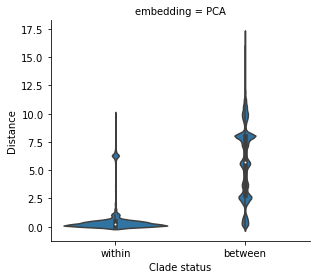

In [48]:
PCA_violin_df = get_euclidean_data_frame(merged_pca_df, "PCA1", "PCA2", "PCA")
g = sns.FacetGrid(
    PCA_violin_df,
    col="embedding",
    col_wrap=3,
    sharey=False,
    height=4
)
g = g.map(sns.violinplot, "clade_status", "distance", order=["within", "between"])
g.set_axis_labels("Clade status", "Distance")
plt.savefig("docs/PCAViolinPlotFlu.png")

In [49]:
total_df = scatterplot_xyvalues(strains, similarity_matrix, merged_pca_df, "PCA1", "PCA2", "PCA")
y_values = statsmodels.nonparametric.smoothers_lowess.lowess(
    total_df["euclidean"],
    total_df["genetic"],
    frac=0.6666666666666666,
    it=3,
    delta=0.0,
    is_sorted=False,
    missing='drop',
    return_sorted=True
)

PD_Y_values = pd.DataFrame(y_values)
PD_Y_values.columns = ["LOWESS_x", "LOWESS_y"]

regression = linregress(total_df["genetic"], total_df["euclidean"])
slope, intercept, r_value, p_value, std_err = regression

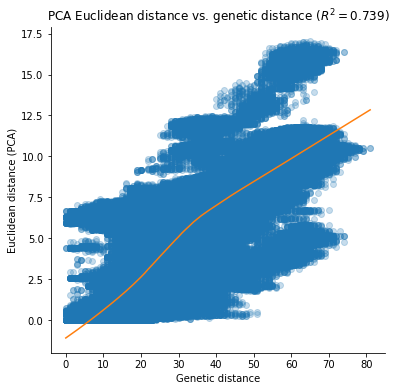

In [50]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6))

ax.plot(total_df["genetic"], total_df["euclidean"], "o", alpha=0.25)
ax.plot(PD_Y_values["LOWESS_x"], PD_Y_values["LOWESS_y"], label="LOESS")

ax.set_xlabel("Genetic distance")
ax.set_ylabel("Euclidean distance (PCA)")
ax.set_title("PCA Euclidean distance vs. genetic distance ($R^2=%.3f$)" % (r_value ** 2))

sns.despine()
plt.savefig("docs/PCAScatterplotLOESSFlu.png")

# Running MDS on the Dataset

In [51]:
embedding = MDS(n_components=10,metric=True,dissimilarity='precomputed')
X_transformed_mds = embedding.fit_transform(similarity_matrix)

In [52]:
raw_stress = embedding.stress_
normalized_stress = np.sqrt(raw_stress /((similarity_matrix.values.ravel() ** 2).sum() / 2))
print(normalized_stress.round(2))

0.08


In [53]:
MDS_df = pd.DataFrame(X_transformed_mds,columns=['MDS' + str(i) for i in range(1,11)])

In [54]:
# Annotate rows by their original strain names. The same logic from PCA holds here
# and for later embeddings.
MDS_df["strain"] = strains

In [55]:
merged_mds_df = MDS_df.merge(node_df, on="strain")

In [56]:
merged_mds_df.head()

,MDS1,MDS2,MDS3,MDS4,MDS5,MDS6,MDS7,MDS8,MDS9,MDS10,strain,date,y,region,country,parent_date,parent_y,clade_membership,clade_membership_color
0,0.340175,-2.899704,-5.823239,0.612103,1.851151,-3.502775,-3.306195,-4.136906,6.818083,5.861129,A/Oman/5263/2017,2017.733744,1331,west_asia,oman,2017.543574,1492.976243,A1b/135K,A1b/135K
1,0.520514,-3.725038,-6.120255,1.054289,0.950803,-2.821775,-2.282811,-5.102466,5.438869,4.358637,A/Oman/5101/2017,2017.739220,1341,west_asia,oman,2017.598698,1340.019618,A1b/135K,A1b/135K
2,0.665341,-6.020714,-5.136510,-0.335794,0.281171,-0.506382,-2.817645,-6.242302,5.226836,4.336796,A/Madagascar/424/2018,2018.101300,1700,africa,madagascar,2017.933265,1698.019618,A1b/135K,A1b/135K
3,2.266094,-4.871518,-6.231908,1.454843,-0.100508,-1.846839,-3.010297,-3.518283,3.200966,5.554771,A/Phetchaburi/104/2018,2018.402464,1385,southeast_asia,thailand,2018.098563,1383.019618,A1b/135K,A1b/135K
4,1.423868,-4.003252,-5.813308,1.230581,0.311363,-2.113652,-2.295575,-3.948785,3.390053,4.503857,A/Philippines/160/2018,2018.098563,1384,southeast_asia,philippines,2018.098563,1383.019618,A1b/135K,A1b/135K


In [57]:
chart_12_mds = scatterplot_with_tooltip_interactive(merged_mds_df,'MDS1','MDS2',"MDS1","MDS2",['strain','clade_membership'],'clade_membership_color')
chart_34_mds = scatterplot_with_tooltip_interactive(merged_mds_df,'MDS3','MDS4',"MDS3","MDS4",['strain','clade_membership'],'clade_membership_color')
chart_56_mds = scatterplot_with_tooltip_interactive(merged_mds_df,'MDS5','MDS6',"MDS5","MDS6",['strain','clade_membership'],'clade_membership_color')
chart_12_mds|chart_34_mds|chart_56_mds

<VegaLite 3 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/troubleshooting.html


In [58]:
chart_MDS = scatterplot_tooltips(strains, similarity_matrix, merged_mds_df, "MDS1", "MDS2", "MDS", 4000)
chart_34_scatter = scatterplot_tooltips(strains, similarity_matrix, merged_mds_df, "MDS3", "MDS4", "MDS", 4000)
chart_56_scatter = scatterplot_tooltips(strains, similarity_matrix, merged_mds_df, "MDS5", "MDS6", "MDS", 4000)
chart_MDS | chart_34_scatter | chart_56_scatter

<VegaLite 3 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/troubleshooting.html


In [59]:
total_df = scatterplot_xyvalues(strains, similarity_matrix, merged_mds_df, "MDS1", "MDS2", "MDS")
y_values = statsmodels.nonparametric.smoothers_lowess.lowess(
    total_df["euclidean"],
    total_df["genetic"],
    frac=0.6666666666666666,
    it=3,
    delta=0.0,
    is_sorted=False,
    missing='drop',
    return_sorted=True
)

PD_Y_values = pd.DataFrame(y_values)
PD_Y_values.columns = ["LOWESS_x", "LOWESS_y"]

regression = linregress(total_df["genetic"], total_df["euclidean"])
slope, intercept, r_value, p_value, std_err = regression

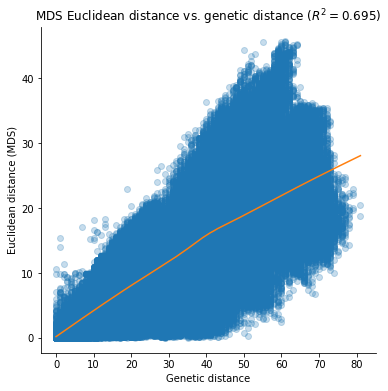

In [60]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6))

ax.plot(total_df["genetic"], total_df["euclidean"], "o", alpha=0.25)
ax.plot(PD_Y_values["LOWESS_x"], PD_Y_values["LOWESS_y"], label="LOESS")

ax.set_xlabel("Genetic distance")
ax.set_ylabel("Euclidean distance (MDS)")
ax.set_title("MDS Euclidean distance vs. genetic distance ($R^2=%.3f$)" % (r_value ** 2))

sns.despine()
plt.savefig("docs/MDSScatterplotLOESSFlu.png")

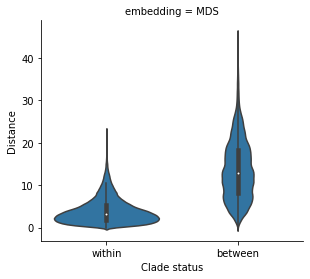

In [61]:
MDS_violin_df = get_euclidean_data_frame(merged_mds_df, "MDS1", "MDS2", "MDS")
g = sns.FacetGrid(
    MDS_violin_df,
    col="embedding",
    col_wrap=3,
    sharey=False,
    height=4
)
g = g.map(sns.violinplot, "clade_status", "distance", order=["within", "between"])
g.set_axis_labels("Clade status", "Distance")
plt.savefig("docs/MDSViolinPlotFlu.png")

In [62]:
list_of_data_and_titles = ['MDS1','MDS2','MDS3','MDS4','MDS5','MDS6']
list_of_chart = linking_tree_with_plots_brush(
    merged_mds_df,
    list_of_data_and_titles,
    list_of_data_and_titles,
    'clade_membership_color',
    ["clade_membership","strain:N"]
)
chart = list_of_chart[0]|list_of_chart[1]|list_of_chart[2]|list_of_chart[3]
chart

<VegaLite 3 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/troubleshooting.html


In [63]:
chart.save("docs/MDSFluBrush.html")

# Running T-SNE on the Dataset 

In [64]:
embedding = TSNE(n_components=2,metric='precomputed',perplexity = 25.95)
X_transformed_tsne = embedding.fit_transform(similarity_matrix)

In [65]:
TSNE_df = pd.DataFrame(X_transformed_tsne,columns=['TSNE' + str(i) for i in range(1,3)])

In [66]:
TSNE_df["strain"] = strains

In [67]:
TSNE_df.head()

,TSNE1,TSNE2,strain
0,-34.398571,-1.441753,A/Oman/5263/2017
1,-33.569908,-1.473734,A/Oman/5101/2017
2,-33.382797,-0.804651,A/Madagascar/424/2018
3,-39.681026,3.028097,A/Phetchaburi/104/2018
4,-39.785065,2.941956,A/Philippines/160/2018


In [68]:
merged_tsne_df = TSNE_df.merge(node_df, on="strain")

In [69]:
scatterplot_with_tooltip_interactive(merged_tsne_df,'TSNE1','TSNE2',"TSNE1","TSNE2",['strain','clade_membership'],'clade_membership_color')

<VegaLite 3 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/troubleshooting.html


In [70]:
list_of_chart = linking_tree_with_plots_brush(
    merged_tsne_df,
    ['TSNE1','TSNE2'],
    ['TSNE1','TSNE2'],
    'clade_membership_color',
    ["clade_membership:N","strain:N"]
)
chart = list_of_chart[0]|list_of_chart[1]
chart
chart.save("docs/TSNEFluBrush.html")

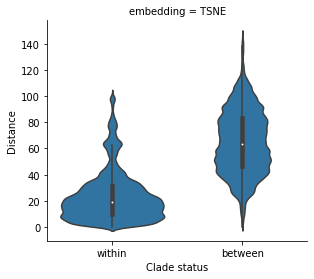

In [71]:
TSNE_violin_df = get_euclidean_data_frame(merged_tsne_df, "TSNE1", "TSNE2", "TSNE")
g = sns.FacetGrid(
    TSNE_violin_df,
    col="embedding",
    col_wrap=3,
    sharey=False,
    height=4
)
g = g.map(sns.violinplot, "clade_status", "distance", order=["within", "between"])
g.set_axis_labels("Clade status", "Distance")
plt.savefig("docs/TSNEViolinPlotFlu.png")

In [72]:
total_df = scatterplot_xyvalues(strains, similarity_matrix, merged_tsne_df, "TSNE1", "TSNE2", "TSNE")
y_values = statsmodels.nonparametric.smoothers_lowess.lowess(
    total_df["euclidean"],
    total_df["genetic"],
    frac=0.6666666666666666,
    it=3,
    delta=0.0,
    is_sorted=False,
    missing='drop',
    return_sorted=True
)

PD_Y_values = pd.DataFrame(y_values)
PD_Y_values.columns = ["LOWESS_x", "LOWESS_y"]

regression = linregress(total_df["genetic"], total_df["euclidean"])
slope, intercept, r_value, p_value, std_err = regression

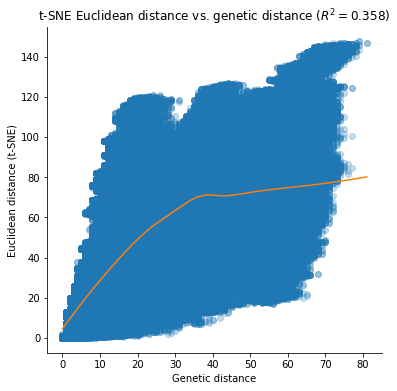

In [73]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6))

ax.plot(total_df["genetic"], total_df["euclidean"], "o", alpha=0.25)
ax.plot(PD_Y_values["LOWESS_x"], PD_Y_values["LOWESS_y"], label="LOESS")

ax.set_xlabel("Genetic distance")
ax.set_ylabel("Euclidean distance (t-SNE)")
ax.set_title("t-SNE Euclidean distance vs. genetic distance ($R^2=%.3f$)" % (r_value ** 2))

sns.despine()
plt.savefig("docs/TSNEScatterplotFlu.png")

# Running UMAP on the Dataset

In [74]:
reducer = umap.UMAP(n_neighbors=200,
        min_dist=.05,
        n_components=2,
        init="spectral")
X_transformed_umap = reducer.fit_transform(similarity_matrix)

In [75]:
UMAP_df = pd.DataFrame(X_transformed_umap,columns=['UMAP' + str(i) for i in range(1,3)])

In [76]:
UMAP_df["strain"] = strains

In [77]:
UMAP_df.head()

,UMAP1,UMAP2,strain
0,1.076012,0.123919,A/Oman/5263/2017
1,1.822239,-1.021446,A/Oman/5101/2017
2,1.166492,-0.004605,A/Madagascar/424/2018
3,1.544718,-0.502644,A/Phetchaburi/104/2018
4,2.078273,-0.881015,A/Philippines/160/2018


In [78]:
merged_umap_df = UMAP_df.merge(node_df, on="strain")

In [79]:
merged_umap_df.head()

,UMAP1,UMAP2,strain,date,y,region,country,parent_date,parent_y,clade_membership,clade_membership_color
0,1.076012,0.123919,A/Oman/5263/2017,2017.733744,1331,west_asia,oman,2017.543574,1492.976243,A1b/135K,A1b/135K
1,1.822239,-1.021446,A/Oman/5101/2017,2017.739220,1341,west_asia,oman,2017.598698,1340.019618,A1b/135K,A1b/135K
2,1.166492,-0.004605,A/Madagascar/424/2018,2018.101300,1700,africa,madagascar,2017.933265,1698.019618,A1b/135K,A1b/135K
3,1.544718,-0.502644,A/Phetchaburi/104/2018,2018.402464,1385,southeast_asia,thailand,2018.098563,1383.019618,A1b/135K,A1b/135K
4,2.078273,-0.881015,A/Philippines/160/2018,2018.098563,1384,southeast_asia,philippines,2018.098563,1383.019618,A1b/135K,A1b/135K


In [80]:
merged_umap_df.shape

(2085, 11)

In [81]:
scatterplot_with_tooltip_interactive(merged_umap_df,'UMAP1','UMAP2',"UMAP1","UMAP2",['strain','clade_membership'],'clade_membership_color')

<VegaLite 3 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/troubleshooting.html


In [82]:
list_of_data_and_titles = ['UMAP1','UMAP2']
list_of_chart = linking_tree_with_plots_brush(
    merged_umap_df,
    list_of_data_and_titles,
    list_of_data_and_titles,
    'clade_membership_color',
    ["clade_membership","strain:N"]
)
chart = list_of_chart[0]|list_of_chart[1]
chart
chart.save("docs/UMAPFluBrush.html")
chart.save("docs/UMAPFluBrush.png")

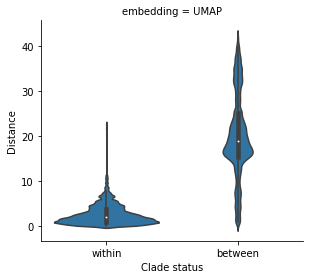

In [83]:
UMAP_violin_df = get_euclidean_data_frame(merged_umap_df, "UMAP1", "UMAP2", "UMAP")
g = sns.FacetGrid(
    UMAP_violin_df,
    col="embedding",
    col_wrap=3,
    sharey=False,
    height=4
)
g = g.map(sns.violinplot, "clade_status", "distance", order=["within", "between"])
g.set_axis_labels("Clade status", "Distance")
plt.savefig("docs/UMAPViolinPlotFlu.png")

In [84]:
total_df = scatterplot_xyvalues(strains, similarity_matrix, merged_umap_df, "UMAP1", "UMAP2", "UMAP")
y_values = statsmodels.nonparametric.smoothers_lowess.lowess(
    total_df["euclidean"],
    total_df["genetic"],
    frac=0.6666666666666666,
    it=3,
    delta=0.0,
    is_sorted=False,
    missing='drop',
    return_sorted=True
)

PD_Y_values = pd.DataFrame(y_values)
PD_Y_values.columns = ["LOWESS_x", "LOWESS_y"]

regression = linregress(total_df["genetic"], total_df["euclidean"])
slope, intercept, r_value, p_value, std_err = regression

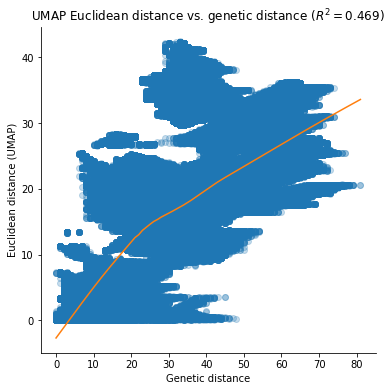

In [85]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6))

ax.plot(total_df["genetic"], total_df["euclidean"], "o", alpha=0.25)
ax.plot(PD_Y_values["LOWESS_x"], PD_Y_values["LOWESS_y"], label="LOESS")

ax.set_xlabel("Genetic distance")
ax.set_ylabel("Euclidean distance (UMAP)")
ax.set_title("UMAP Euclidean distance vs. genetic distance ($R^2=%.3f$)" % (r_value ** 2))

sns.despine()
plt.savefig("docs/UMAPScatterplotFlu.png")

# Linking all plots together clickable with Tree

In [86]:
merged_df = node_df.merge(
    principalDf,
    on="strain"
).merge(
    MDS_df,
    on="strain"
).merge(
    TSNE_df,
    on="strain"
).merge(
    UMAP_df,
    on="strain"
)

In [87]:
merged_df.shape

(2085, 33)

In [88]:
merged_df.head()

,strain,date,y,region,country,parent_date,parent_y,clade_membership,clade_membership_color,PCA1,...,MDS5,MDS6,MDS7,MDS8,MDS9,MDS10,TSNE1,TSNE2,UMAP1,UMAP2
0,A/Almaty/2958/2013,2013.073922,0,west_asia,kazakhstan,2012.995475,0.000000,3c3,other,-0.390299,...,14.990711,12.817575,0.536668,3.785205,1.495259,-11.835883,1.682396,37.654335,17.091829,1.948707
1,A/Victoria/505/2013,2013.459959,1,oceania,australia,2013.293896,0.019618,3c3,other,-0.392178,...,-0.116332,13.264300,9.822922,-0.078037,0.430833,0.955293,1.710790,37.630886,17.146576,1.962599
2,A/Newcastle/22/2014,2014.457221,2,oceania,australia,2013.293896,0.019618,3c3.B,other,-0.262780,...,9.637987,12.017019,23.595199,14.779057,2.824628,-3.796192,1.930783,37.439571,17.074223,2.200471
3,A/Stockholm/6/2014,2014.101300,3,europe,sweden,2013.840269,2.941146,3c3.A,3c3.A,-0.408988,...,4.272205,19.352796,5.845705,3.291951,1.005347,-2.541227,1.010220,38.462128,17.161411,2.088327
4,A/Switzerland/9715293/2013,2013.930869,4,europe,switzerland,2013.930869,4.362673,3c3.A,3c3.A,-0.399185,...,4.504680,20.151182,5.428003,3.430139,0.963877,-3.782656,0.913187,38.513256,17.165075,2.085769


In [89]:
data = linking_tree_with_plots_clickable(
    merged_df,
    ['MDS1', 'MDS2','TSNE1', 'TSNE2', 'PCA1', 'PCA2', 'UMAP1', 'UMAP2'],
    ['MDS1', 'MDS2', 'TSNE1', 'TSNE2','PCA1 (Expected Variance : {}%'.format(round(pca.explained_variance_ratio_[0]*100,2)) + ")",
    'PCA2 (Expected Variance : {}%'.format(round(pca.explained_variance_ratio_[1]*100,2)) + ")",'UMAP1','UMAP2'],
    'clade_membership_color:N',
    ['clade_membership'],
    ['strain','clade_membership']
)

In [90]:
data1 = linking_tree_with_plots_brush(
    merged_df,
    ['TSNE1', 'TSNE2','UMAP1', 'UMAP2'],
    ['TSNE1', 'TSNE2','UMAP1','UMAP2'],
    'clade_membership_color:N',
    ['strain','clade_membership']
)

In [91]:
TSNEUMAP = data1[0]|data1[1]|data1[2]
TSNEUMAP.save('docs/TSNEUMAPClickableFlu.html')
TSNEUMAP

<VegaLite 3 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/troubleshooting.html


In [92]:
PCAMDS = data[3]|data[1]|data[5]
TSNEUMAP = data[2]|data[4]
embeddings = alt.vconcat(PCAMDS,TSNEUMAP)
embeddings
fullChart = alt.hconcat(data[0],embeddings)
fullChart.save('docs/FullLinkedChartClickableFlu.html')
fullChart.save('docs/FullLinkedChartClickableFlu.png')
fullChart

<VegaLite 3 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/troubleshooting.html


## Scatterplots for all embeddings 
Concatenating all embedding data frames to plot genetic vs Euclidean distance for each embedding

In [93]:
umap_df = scatterplot_xyvalues(strains, similarity_matrix, merged_umap_df, "UMAP1", "UMAP2", "UMAP")
tsne_df = scatterplot_xyvalues(strains, similarity_matrix, merged_tsne_df, "TSNE1", "TSNE2", "TSNE")
mds_df = scatterplot_xyvalues(strains, similarity_matrix, merged_mds_df, "MDS1", "MDS2", "MDS")
pca_df = scatterplot_xyvalues(strains, similarity_matrix, merged_pca_df, "PCA1", "PCA2", "PCA")

y_values_umap = statsmodels.nonparametric.smoothers_lowess.lowess(
    umap_df["euclidean"],
    umap_df["genetic"],
    frac=0.6666666666666666,
    it=3,
    delta=0.0,
    is_sorted=False,
    missing='drop',
    return_sorted=True
)

y_values_tsne = statsmodels.nonparametric.smoothers_lowess.lowess(
    tsne_df["euclidean"],
    tsne_df["genetic"],
    frac=0.6666666666666666,
    it=3,
    delta=0.0,
    is_sorted=False,
    missing='drop',
    return_sorted=True
)

y_values_mds = statsmodels.nonparametric.smoothers_lowess.lowess(
    mds_df["euclidean"],
    mds_df["genetic"],
    frac=0.6666666666666666,
    it=3,
    delta=0.0,
    is_sorted=False,
    missing='drop',
    return_sorted=True
)

y_values_pca = statsmodels.nonparametric.smoothers_lowess.lowess(
    pca_df["euclidean"],
    pca_df["genetic"],
    frac=0.6666666666666666,
    it=3,
    delta=0.0,
    is_sorted=False,
    missing='drop',
    return_sorted=True
)

PD_Y_values_umap = pd.DataFrame(y_values_umap)
PD_Y_values_umap.columns = ["LOWESS_x", "LOWESS_y"]

regression_umap = linregress(umap_df["genetic"], umap_df["euclidean"])
slope, intercept, r_value_umap, p_value, std_err = regression_umap

PD_Y_values_tsne = pd.DataFrame(y_values_tsne)
PD_Y_values_tsne.columns = ["LOWESS_x", "LOWESS_y"]

regression_tsne = linregress(tsne_df["genetic"], tsne_df["euclidean"])
slope, intercept, r_value_tsne, p_value, std_err = regression_tsne

PD_Y_values_mds = pd.DataFrame(y_values_mds)
PD_Y_values_mds.columns = ["LOWESS_x", "LOWESS_y"]

regression_mds = linregress(mds_df["genetic"], mds_df["euclidean"])
slope, intercept, r_value_mds, p_value, std_err = regression_mds

PD_Y_values_pca = pd.DataFrame(y_values_pca)
PD_Y_values_pca.columns = ["LOWESS_x", "LOWESS_y"]

regression_pca = linregress(pca_df["genetic"], pca_df["euclidean"])
slope, intercept, r_value_pca, p_value, std_err = regression_pca

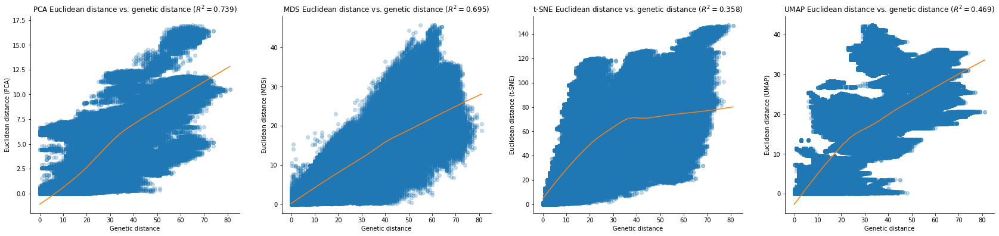

In [94]:
fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(24, 6))
fig.tight_layout(pad=4.0)

ax1.plot(pca_df["genetic"], pca_df["euclidean"], "o", alpha=0.25)
ax1.plot(PD_Y_values_pca["LOWESS_x"], PD_Y_values_pca["LOWESS_y"], label="LOESS")

ax1.set_xlabel("Genetic distance")
ax1.set_ylabel("Euclidean distance (PCA)")
ax1.set_title("PCA Euclidean distance vs. genetic distance ($R^2=%.3f$)" % (r_value_pca ** 2))

ax2.plot(mds_df["genetic"], mds_df["euclidean"], "o", alpha=0.25)
ax2.plot(PD_Y_values_mds["LOWESS_x"], PD_Y_values_mds["LOWESS_y"], label="LOESS")

ax2.set_xlabel("Genetic distance")
ax2.set_ylabel("Euclidean distance (MDS)")
ax2.set_title("MDS Euclidean distance vs. genetic distance ($R^2=%.3f$)" % (r_value_mds ** 2))

ax3.plot(tsne_df["genetic"], tsne_df["euclidean"], "o", alpha=0.25)
ax3.plot(PD_Y_values_tsne["LOWESS_x"], PD_Y_values_tsne["LOWESS_y"], label="LOESS")

ax3.set_xlabel("Genetic distance")
ax3.set_ylabel("Euclidean distance (t-SNE)")
ax3.set_title("t-SNE Euclidean distance vs. genetic distance ($R^2=%.3f$)" % (r_value_tsne ** 2))

ax4.plot(umap_df["genetic"], umap_df["euclidean"], "o", alpha=0.25)
ax4.plot(PD_Y_values_umap["LOWESS_x"], PD_Y_values_umap["LOWESS_y"], label="LOESS")

ax4.set_xlabel("Genetic distance")
ax4.set_ylabel("Euclidean distance (UMAP)")
ax4.set_title("UMAP Euclidean distance vs. genetic distance ($R^2=%.3f$)" % (r_value_umap ** 2))


sns.despine()
plt.savefig("docs/FullScatterplotFlu.png")

## Within- and between-clade Euclidean distances for all embeddings

Use the complete embedding data frame to calculate pairwise Euclidean distances between samples and plot the results in a single figure.

In [95]:
data_frames = [
    get_euclidean_data_frame(merged_df, "PCA1", "PCA2", "PCA"),
    get_euclidean_data_frame(merged_df, "MDS1", "MDS2", "MDS"),
    get_euclidean_data_frame(merged_df, "TSNE1", "TSNE2", "t-SNE"),
    get_euclidean_data_frame(merged_df, "UMAP1", "UMAP2", "UMAP"),
]

Extract pairwise genetic (Hamming) distances corresponding to the records sampled above. This step assumes that the original merged data frame is indexed from zero to N for N total samples in the same order as the similarity matrix.

In [96]:
genetic_distances = squareform(similarity_matrix)

In [97]:
data_frames.append(pd.DataFrame({
    "distance": genetic_distances,
    "clade_status": data_frames[0]["clade_status"].values,
    "embedding": "genetic"
}))

In [98]:
len(data_frames)

5

In [99]:
euclidean_data_frame = pd.concat(data_frames)

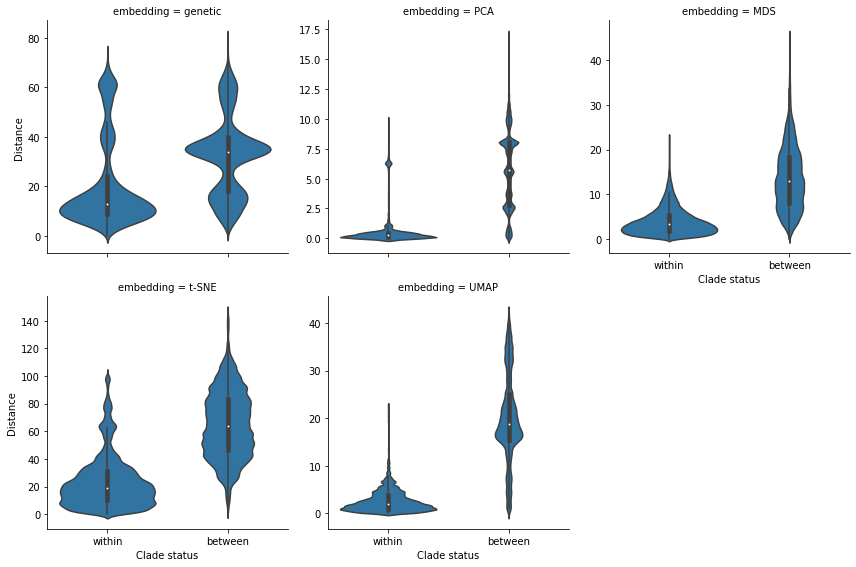

In [100]:
g = sns.FacetGrid(
    euclidean_data_frame,
    col="embedding",
    col_wrap=3,
    col_order=["genetic", "PCA", "MDS", "t-SNE", "UMAP"],
    sharey=False,
    height=4
)
g = g.map(sns.violinplot, "clade_status", "distance", order=["within", "between"])
g.set_axis_labels("Clade status", "Distance")
plt.savefig("docs/FullViolinPlotFlu.png")

In [101]:
PCA_df = euclidean_data_frame[euclidean_data_frame.embedding == "PCA"]
MDS_df = euclidean_data_frame[euclidean_data_frame.embedding == "MDS"]
TSNE_df = euclidean_data_frame[euclidean_data_frame.embedding == "t-SNE"]
UMAP_df = euclidean_data_frame[euclidean_data_frame.embedding == "UMAP"]
genetic_df = euclidean_data_frame[euclidean_data_frame.embedding == "genetic"]

In [102]:
genetic_df

,distance,clade_status,embedding
0,3.0,within,genetic
1,4.0,between,genetic
2,6.0,between,genetic
3,5.0,between,genetic
4,6.0,between,genetic
...,...,...,...
2172565,14.0,within,genetic
2172566,20.0,within,genetic
2172567,17.0,within,genetic
2172568,21.0,within,genetic


In [103]:
genetic_df['distance'].mean()

30.309177149643048

In [104]:
median_genetic_within = genetic_df[genetic_df.clade_status == "within"].median()
median_genetic_between = genetic_df[genetic_df.clade_status == "between"].median()

In [105]:
median_PCA_within = PCA_df[PCA_df.clade_status == "within"].median()
median_PCA_between = PCA_df[PCA_df.clade_status == "between"].median()

In [106]:
median_MDS_within = MDS_df[MDS_df.clade_status == "within"].median()
median_MDS_between = MDS_df[MDS_df.clade_status == "between"].median()

In [107]:
median_TSNE_within = TSNE_df[TSNE_df.clade_status == "within"].median()
median_TSNE_between = TSNE_df[TSNE_df.clade_status == "between"].median()

In [108]:
median_UMAP_within = UMAP_df[UMAP_df.clade_status == "within"].median()
median_UMAP_between = UMAP_df[UMAP_df.clade_status == "between"].median()

In [109]:
def ratioFunction(num1, num2):
    ratio12 = int(num1/num2)
    return ratio12

In [110]:
genetic_ratio = ratioFunction(median_genetic_between,median_genetic_within)
print(genetic_ratio)

2


In [111]:
PCA_ratio = ratioFunction(median_PCA_between,median_PCA_within)
print(PCA_ratio)

24


In [112]:
MDS_ratio = ratioFunction(median_MDS_between,median_MDS_within)
print(MDS_ratio)

3


In [113]:
TSNE_ratio = ratioFunction(median_TSNE_between,median_TSNE_within)
print(TSNE_ratio)

3


In [114]:
UMAP_ratio = ratioFunction(median_UMAP_between,median_UMAP_within)
print(UMAP_ratio)

9


## Missing Bases Analysis

(low importance)
- use strains and cluster by K-means
- find accuracy by taking into account the total amount of relationships between clusters and taking the percentage of them which are STILL correct (ex. within/between stays within/between)
    - this allows you to reuse code if needed

In [115]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=7, init='k-means++', n_init=10, max_iter=300, tol=0.0001, precompute_distances='auto', verbose=0, random_state=None, copy_x=True, n_jobs=None, algorithm='auto')
kmeans_data= kmeans.fit(X_transformed_tsne)

In [116]:
merged_tsne_df_copy = merged_tsne_df.copy()
merged_tsne_df_copy["clade_membership"] = kmeans_data.labels_

In [117]:
brush = alt.selection(type='interval', resolve='global')
chart = alt.Chart(merged_tsne_df_copy).mark_circle(size=60).encode(
    x=alt.X("TSNE1", title="TSNE1"),
    y=alt.X("TSNE2", title="TSNE2"),
    color=alt.Color('clade_membership',
               scale=alt.Scale(
        domain = ["0", "1", "2", "3", "4", "5", "6"],
        range=['blue', 'orange', "red", "light blue", "green", "yellow", "purple"])),
    tooltip=["strain", "clade_membership"]
).interactive()
chart.display()

<VegaLite 3 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/troubleshooting.html


In [118]:
chart2 = scatterplot_with_tooltip_interactive(merged_tsne_df,'TSNE1','TSNE2',"TSNE1","TSNE2",['strain','clade_membership'],'clade_membership_color')

In [119]:
chart | chart2

<VegaLite 3 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/troubleshooting.html


In [120]:
merged_tsne_df_copy = get_euclidean_data_frame(merged_tsne_df_copy, "TSNE1", "TSNE2", "TSNE")

In [121]:
diff_btw_df = TSNE_violin_df["clade_status"] == merged_tsne_df_copy["clade_status"]
diff_btw_df.sum()

1953148

In [122]:
((diff_btw_df.sum() / TSNE_violin_df.shape[0])*100)

89.90034843526331

In [123]:
from sklearn.metrics import confusion_matrix
confusion = confusion_matrix(TSNE_violin_df["clade_status"], merged_tsne_df_copy["clade_status"])
confusion_df = pd.DataFrame(confusion)

In [124]:
confusion_df.columns = ["False", "True"]
confusion_df.index = ["False", "True"]
confusion_df

,False,True
False,1687318,103476
True,115946,265830


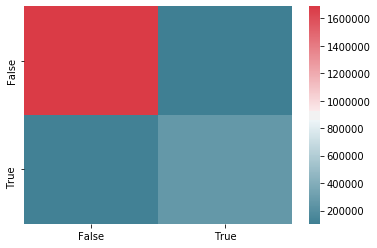

In [125]:
sns.heatmap(confusion_df, cmap = sns.diverging_palette(220, 10, as_cmap=True))

In [126]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=7, init='k-means++', n_init=10, max_iter=300, tol=0.0001, precompute_distances='auto', verbose=0, random_state=None, copy_x=True, n_jobs=None, algorithm='auto')
kmeans_data= kmeans.fit(X_transformed_umap)

In [127]:
merged_umap_df_copy = merged_umap_df.copy()
merged_umap_df_copy["clade_membership"] = kmeans_data.labels_

In [128]:
brush = alt.selection(type='interval', resolve='global')
chart = alt.Chart(merged_umap_df_copy).mark_circle(size=60).encode(
    x=alt.X("UMAP1", title="UMAP1"),
    y=alt.X("UMAP2", title="UMAP2"),
    color=alt.Color('clade_membership',
               scale=alt.Scale(
        domain = ["0", "1", "2", "3", "4", "5", "6"],
        range=['blue', 'orange', "red", "light blue", "green", "yellow", "purple"])),
    tooltip=["strain", "clade_membership"]
).interactive()
chart.display()

<VegaLite 3 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/troubleshooting.html


In [129]:
chart2 = scatterplot_with_tooltip_interactive(merged_umap_df,'UMAP1','UMAP2',"UMAP1","UMAP2",['strain','clade_membership'],'clade_membership_color')

In [130]:
chart | chart2

<VegaLite 3 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/troubleshooting.html


In [131]:
merged_umap_df_copy = get_euclidean_data_frame(merged_umap_df_copy, "UMAP1", "UMAP2", "UMAP")

In [132]:
diff_btw_df = UMAP_violin_df["clade_status"] == merged_umap_df_copy["clade_status"]
diff_btw_df.sum()

2007573

In [133]:
((diff_btw_df.sum() / UMAP_violin_df.shape[0])*100)

92.40544608459106

In [134]:
from sklearn.metrics import confusion_matrix
confusion = confusion_matrix(UMAP_violin_df["clade_status"], merged_umap_df_copy["clade_status"])
confusion_df = pd.DataFrame(confusion)

In [135]:
confusion_df.columns = ["False", "True"]
confusion_df.index = ["False", "True"]
confusion_df

,False,True
False,1697219,93575
True,71422,310354


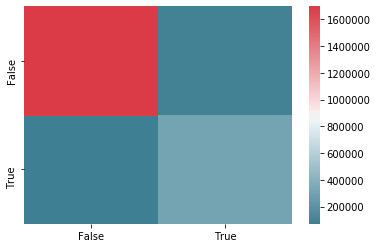

In [136]:
sns.heatmap(confusion_df, cmap = sns.diverging_palette(220, 10, as_cmap=True))

In [137]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=7, init='k-means++', n_init=10, max_iter=300, tol=0.0001, precompute_distances='auto', verbose=0, random_state=None, copy_x=True, n_jobs=None, algorithm='auto')
kmeans_data= kmeans.fit(X_transformed_mds)

In [138]:
merged_mds_df_copy = merged_mds_df.copy()
merged_mds_df_copy["clade_membership"] = kmeans_data.labels_

In [139]:
brush = alt.selection(type='interval', resolve='global')
chart = alt.Chart(merged_mds_df_copy).mark_circle(size=60).encode(
    x=alt.X("MDS1", title="MDS1"),
    y=alt.X("MDS2", title="MDS2"),
    color=alt.Color('clade_membership',
               scale=alt.Scale(
        domain = ["0", "1", "2", "3", "4", "5", "6"],
        range=['blue', 'orange', "red", "light blue", "green", "yellow", "purple"])),
    tooltip=["strain", "clade_membership"]
).interactive()
chart.display()

<VegaLite 3 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/troubleshooting.html


In [140]:
chart2 = scatterplot_with_tooltip_interactive(merged_mds_df,'MDS1','MDS2',"MDS1","MDS2",['strain','clade_membership'],'clade_membership_color')

In [141]:
chart | chart2

<VegaLite 3 object>

If you see this message, it means the renderer has not been properly enabled
for the frontend that you are using. For more information, see
https://altair-viz.github.io/user_guide/troubleshooting.html


In [142]:
merged_mds_df_copy = get_euclidean_data_frame(merged_mds_df_copy, "MDS1", "MDS2", "MDS")

In [143]:
diff_btw_df = MDS_violin_df["clade_status"] == merged_mds_df_copy["clade_status"]
diff_btw_df.sum()

2091826

In [144]:
((diff_btw_df.sum() / MDS_violin_df.shape[0])*100)

96.28347993390317

In [145]:
from sklearn.metrics import confusion_matrix
confusion = confusion_matrix(MDS_violin_df["clade_status"], merged_mds_df_copy["clade_status"])
confusion_df = pd.DataFrame(confusion)

In [146]:
confusion_df.columns = ["False", "True"]
confusion_df.index = ["False", "True"]
confusion_df

,False,True
False,1716484,74310
True,6434,375342


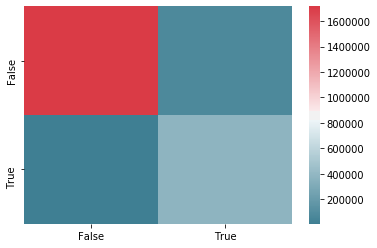

In [147]:
sns.heatmap(confusion_df, cmap = sns.diverging_palette(220, 10, as_cmap=True))